# How to Create Interactive Maps for Crowdfunding Campaigns?

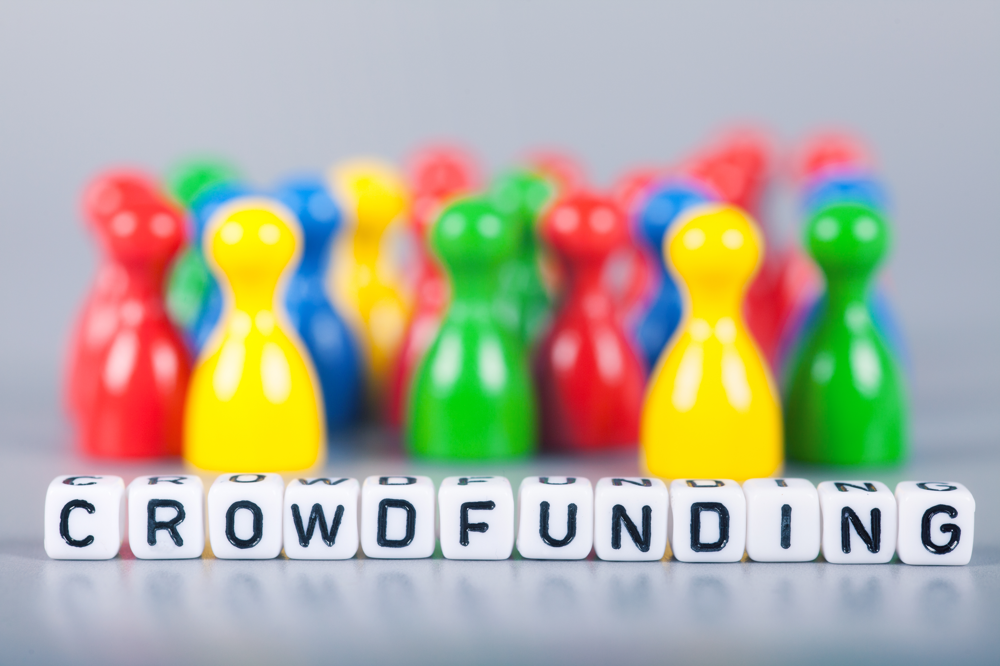

Creating very visual interactive maps is now possible with Python thanks to Leaflet (http://leafletjs.com/) an open-source JavaScript library for mobile-friendly interactive maps. This notebook is just an example of how this library can be used for your crowdfunding campaign. 

We are using it for our crowdfunding campaign, called "UnGometVermell" (A Red Sticker) to raise funds for social animation in public hospitals around Barcelona. This is our website: www.ungometvermell.cat

Be part of this fantastic community of strangers helping strangers and make a donation at https://www.migranodearena.org/ca/repte/16694/un-gomet-vermell

In [5]:
# import python libraries 
import folium
import pandas as pd
from geopy.geocoders import Nominatim

In [6]:
# import your excel file with postal codes from donors 
data = pd.read_excel('UnGometVermell.xlsx',converters={'Zip Code':str,'Amount':int})
data.head()

,Zip Code,Amount
0,08208,100
1,08005,75
2,08201,50
3,08032,200
4,17003,300


In [7]:
nom = Nominatim()

In [8]:
data['Coordinates']=data['Zip Code'].apply(nom.geocode)

In [9]:
# compute geo coordinates 
data['Latitude']=data['Coordinates'].apply(lambda x: x.latitude if x != None else None)
data['Longitude']=data['Coordinates'].apply(lambda x: x.longitude if x != None else None)

In [10]:
data

,Zip Code,Amount,Coordinates,Latitude,Longitude
0,08208,100,"(Sabadell, CAT, 08208, España, (41.55524983090...",41.555250,2.100216
1,08005,75,"(el Poblenou, CAT, 08005, España, (41.39567607...",41.395676,2.197261
2,08201,50,"(Sabadell, CAT, 08201, España, (41.5462829, 2....",41.546283,2.106114
3,08032,200,"(el Carmel, CAT, 08032, España, (41.4182944877...",41.418294,2.160613
4,17003,300,"(Palau, CAT, 17003, España, (41.9653035328641,...",41.965304,2.821540
5,17001,275,"(Eixample, CAT, 17001, España, (41.98396423069...",41.983964,2.819450
6,43500,100,"(Tortosa, CAT, 43500, España, (40.810001237154...",40.810001,0.520186
7,25005,1000,"(Lleida, CAT, 25005, España, (41.6287300486563...",41.628730,0.627475
8,25198,1500,"(Lleida, CAT, 25198, España, (41.626920735501,...",41.626921,0.605238
9,43002,250,"(Tarragona, CAT, 43002, España, (41.1220948823...",41.122095,1.249839


In [20]:
# Set a color according to the amount donation 
def color_producer(amount):
    if amount < 100:
        return 'green'
    elif 100 <= amount < 500:
        return 'orange'
    else:
        return 'red'

In [15]:
lat = list(data['Latitude'])
lon = list(data['Longitude'])
money = list(data['Amount'])

In [21]:
# Set the reference coordinates for the map center (ex. around Barcelona, Catalonia) and the scale (8)
map = folium.Map(location=[41.538113,2.444741],zoom_start=8)

In [17]:
# Make the interactive map 
fg = folium.FeatureGroup(name="Our campaign")
for lt, ln, amount in zip(lat, lon, money):
    fg.add_child(folium.CircleMarker(location=[lt, ln], radius = 6, popup=str(amount)+" €",
    fill_color=color_producer(amount), fill=True,  color = 'grey', fill_opacity=0.7))

In [18]:
map.add_child(fg)

In [19]:
map.save('OurCampaign.html') # this html code can be easily embedded in any web editor such as Wix or Wordpress

## Loved the project? 

Then clone it and use it for your own crowdfunding campaigns! I would also really appreciate it if you could 'Star' it on Github and make a donation to: https://www.migranodearena.org/ca/repte/16694/un-gomet-vermell
to support clowncare initiatives for children and mental health patients! Let's join the fight against illness and chronic pain with an smile!

For any question please do not hesitate to contact me on Github (/gloriamacia) or LinkedIn (in/gloriamacia) 

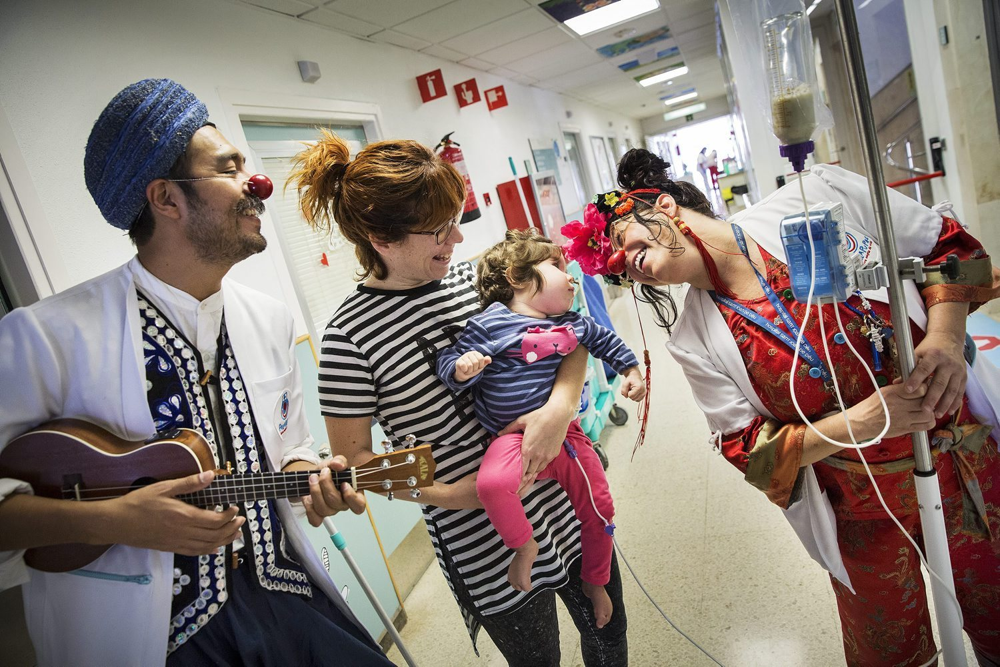
www.ungometvermell.cat